In [1]:

import keras
import tensorflow as tf
from tensorflow.python.ops import array_ops
from keras import metrics
from keras.models import Sequential, Model
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Concatenate
from keras.layers import Activation, Dropout, Flatten, Dense, Input, BatchNormalization
from keras.optimizers import RMSprop
from keras import backend as K
from keras.optimizers import SGD
from keras.optimizers import Adam
from keras.applications.vgg19 import VGG19
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, Callback

Using TensorFlow backend.


In [1]:
import datetime
from matplotlib.image import imread

In [3]:
%widescreen

In [3]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 11833496368607856867
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 9316822125849847418
physical_device_desc: "device: XLA_GPU device"
, name: "/device:XLA_GPU:1"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 14246711821400358424
physical_device_desc: "device: XLA_GPU device"
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 3350448162412068771
physical_device_desc: "device: XLA_CPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 10895235482
locality {
  bus_id: 1
  links {
  }
}
incarnation: 1167945273486183170
physical_device_desc: "device: 0, name: GeForce GTX 1080 Ti, pci bus id: 0000:17:00.0, compute capability: 6.1"
]


In [4]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [26]:
input_image_size = (480,640,3)

base_model = VGG19(
    include_top=False, 
    weights='imagenet', 
    input_shape=(input_image_size), 
)

for layer in base_model.layers:
    layer.trainable = False

#Adding custom Layers 
x = base_model.output
x = Flatten()(x)
x = Dense(512, activation="relu")(x)
# x = Dropout(0.25)(x)
# x = Dense(512, activation="relu")(x)
predictions = Dense(1, activation='sigmoid')(x)

# creating the final model 
model = Model(input = base_model.input, output = predictions)

# compile the model 
model.compile(
    loss = "binary_crossentropy", 
    optimizer = Adam(), #SGD(lr=0.0001, momentum=0.9), 
    metrics=["accuracy"]
)
    


/home/dougo/.conda/envs/keras/lib/python3.6/site-packages/ipykernel_launcher.py:21: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("de...)`


In [19]:
model.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 480, 640, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 480, 640, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 480, 640, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 240, 320, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 240, 320, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 240, 320, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 120, 160, 128)     0   

In [7]:
# model.load_weights("model_weights_checkpoint_2020-02-05T13_43_24.296156.h5")

In [22]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.25,
    zoom_range=0.25,
    rotation_range=0.2,
)
train_generator = train_datagen.flow_from_directory(
    directory=r"/ssd1/lick_detection_model/train/",
    target_size=(480,640),
    color_mode="rgb",
    batch_size=8,
    class_mode="binary",
    shuffle=True,
    seed=42
)

Found 2386 images belonging to 2 classes.


In [9]:
nonshuffled_train_generator = train_datagen.flow_from_directory(
    directory=r"/ssd1/lick_detection_model/train/",
    target_size=(480,640),
    color_mode="rgb",
    batch_size=8,
    class_mode="binary",
    shuffle=False,
    seed=42
)

Found 2386 images belonging to 2 classes.


In [11]:
valid_datagen = ImageDataGenerator(
    rescale=1./255,
#     shear_range=0.2,
#     zoom_range=0.2,
#     rotation_range=0.2,
)
valid_generator = valid_datagen.flow_from_directory(
    directory=r"/ssd1/lick_detection_model/validate/",
    target_size=(480,640),
    color_mode="rgb",
    batch_size=8,
    class_mode="binary",
    shuffle=True,
    seed=42
)

Found 298 images belonging to 2 classes.


In [12]:
test_datagen = ImageDataGenerator(
    rescale=1./255,
)
test_generator = valid_datagen.flow_from_directory(
    directory=r"/ssd1/lick_detection_model/test/",
    target_size=(480,640),
    color_mode="rgb",
    batch_size=8,
    class_mode="binary",
    shuffle=False,
)

Found 298 images belonging to 2 classes.


In [23]:
# setup callbacks
earlystop = EarlyStopping(patience=10)

datestamp = str(datetime.datetime.now()).replace(':','_').replace(' ','T')

checkpoint_name = "model_weights_checkpoint_{}.h5".format(datestamp)
checkpoint = ModelCheckpoint(
                            checkpoint_name, 
                            monitor='val_accuracy', 
                            verbose=0, 
                            save_best_only=True, 
                            save_weights_only=True,
                            mode='auto')

callbacks = [earlystop, checkpoint]

In [24]:
STEP_SIZE_TRAIN

298

In [ ]:
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=valid_generator.n//valid_generator.batch_size

history_2 = model.fit_generator(generator=train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=valid_generator,
                    validation_steps=STEP_SIZE_VALID,
                    epochs=50,
                    callbacks = callbacks,
)

Epoch 1/50
298/298 [==============================] - 161s 540ms/step - loss: 0.1163 - accuracy: 0.9525 - val_loss: 0.0963 - val_accuracy: 0.9054
Epoch 2/50
298/298 [==============================] - 158s 530ms/step - loss: 0.1385 - accuracy: 0.9441 - val_loss: 0.0651 - val_accuracy: 0.9000
Epoch 3/50
298/298 [==============================] - 157s 526ms/step - loss: 0.1049 - accuracy: 0.9588 - val_loss: 0.6861 - val_accuracy: 0.8897
Epoch 4/50
298/298 [==============================] - 163s 547ms/step - loss: 0.1594 - accuracy: 0.9373 - val_loss: 1.1194 - val_accuracy: 0.9000
Epoch 5/50
298/298 [==============================] - 158s 530ms/step - loss: 0.1036 - accuracy: 0.9617 - val_loss: 0.0512 - val_accuracy: 0.9000
Epoch 6/50
298/298 [==============================] - 157s 527ms/step - loss: 0.1206 - accuracy: 0.9495 - val_loss: 0.1716 - val_accuracy: 0.9138
Epoch 7/50
298/298 [==============================] - 156s 522ms/step - loss: 0.1226 - accuracy: 0.9516 - val_loss: 1.0464 -

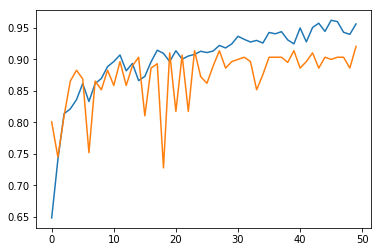

In [31]:
fig,ax=plt.subplots()
ax.plot(history.history['accuracy'])
ax.plot(history.history['val_accuracy'])

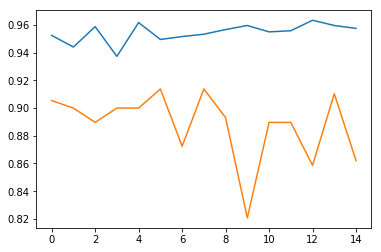

In [33]:
fig,ax=plt.subplots()
ax.plot(history_2.history['accuracy'])
ax.plot(history_2.history['val_accuracy'])

In [34]:
def visualize_predictions(model, generator):
    generator.reset()
    print('making predictions')
    predictions = model.predict_generator(generator)
    print('done with predictions')
    indices = np.arange(len(generator.filenames))
    datapath = generator.directory
    
    fig,axes=plt.subplots(int(np.ceil(len(generator.filenames)/8)),8,figsize=(25,2.5*np.ceil(len(generator.filenames)/8)))
    for ii,index in enumerate(indices):
        ax = axes.flatten()[ii]
        filename = os.path.join(datapath,generator.filenames[index])
        actual_label = int(generator.filenames[index][:1])

        image = imread(filename)
        ax.imshow(image)
        ax.set_title(
            '{}\nactual_label = {}\nlick probability = {:.4f}'.format(generator.filenames[index], actual_label, predictions[index][0]),
            fontsize=10,
        )
        ax.set_xticks([])
        ax.set_yticks([])

        if round(predictions[index][0]) == actual_label:
            color='green'
        else:
            color='red'
        for spine in ax.spines.values():
            spine.set_edgecolor(color)
            spine.set_linewidth(5)

    fig.tight_layout()
    
    return fig,axes

making predictions
done with predictions


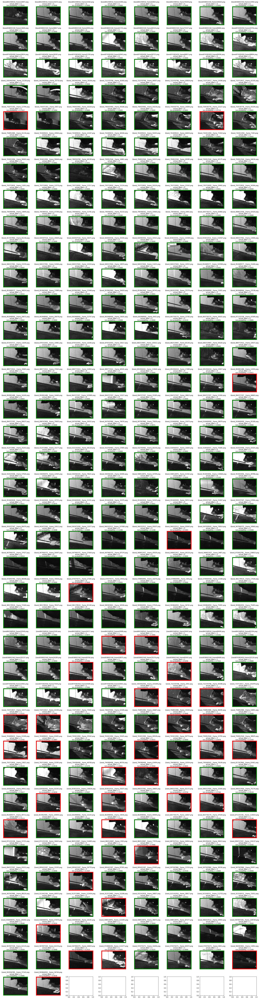

In [35]:
fig,axes = visualize_predictions(model,test_generator)

making predictions
done with predictions


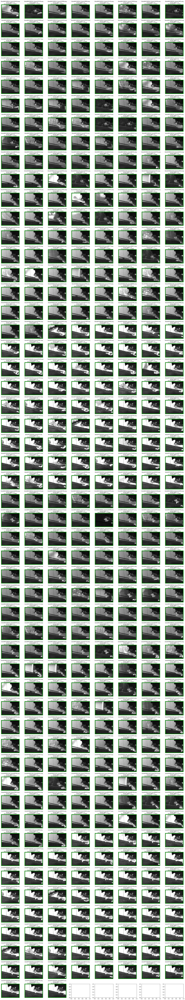

In [45]:
fig,axes = visualize_predictions(model,nonshuffled_train_generator)